In [1]:
import pickle
import pandas as pd
import numpy as np
import plotly.express as px

import starterkits.starterkit_4_2.support as sp
import starterkits.starterkit_4_2.visualizations as vis

%load_ext autoreload
%autoreload 2

# from SunRISE.electrical_consumption.pso import *

### Read csv file
SKIP THIS SECTION

Reading the complete csv file every time takes a long time, better idea is to read it once, take a sample of consumers and store this subset.

In [4]:
def load_public_dataset(path):
    """ Load full csv file."""
    data_full = pd.read_csv('public_data/CC_LCL-FullData.csv')
    data_std = data_full[data_full.stdorToU == 'Std']
    data_std['DateTime'] = pd.to_datetime(data_std['DateTime'])
    data_std.rename({'LCLid': 'household', 'DateTime': 'timestamp'}, axis=1, inplace=True)
    
    return data_std

def take_subset(df, select_n_cons):
    """ Take sample of consumers with sufficient consumption data."""
    df.replace(to_replace='Null', value=0, inplace=True)
    data_limits = df.groupby('household').timestamp.agg(['first', 'last'])
    
    # check which consumers have consumption data from 1st January 2013 to 28th February 2014
    mask = np.where((data_limits['first'] < '2012-01-01') & (data_limits['last'] > '2014-01-01'), True, False)
    potential_consumers = data_limits[mask].index.to_list()
    
    # take sample of n consumers
    sample_cons = random.sample(potential_consumers, select_n_cons)
    
    consumer_subset = df[df.household.isin(sample_cons)].reset_index(drop=True).drop(columns=['stdorToU'])
    consumer_subset.columns = ['consumer', 'timestamp', 'consumption']
    consumer_subset.drop_duplicates(inplace=True)
    
    return consumer_subset, sample_cons

In [5]:
df = load_public_dataset('public_data/CC_LCL-FullData.csv')
df.head()

,household,stdorToU,timestamp,KWH/hh (per half hour)
0,MAC000002,Std,2012-10-12 00:30:00,0
1,MAC000002,Std,2012-10-12 01:00:00,0
2,MAC000002,Std,2012-10-12 01:30:00,0
3,MAC000002,Std,2012-10-12 02:00:00,0
4,MAC000002,Std,2012-10-12 02:30:00,0


In [109]:
consumer_subset, sample_cons = take_subset(df, 300)
consumer_subset

,consumer,timestamp,consumption
0,MAC000018,2011-12-07 09:30:00,0.303
1,MAC000018,2011-12-07 10:00:00,0.2
2,MAC000018,2011-12-07 10:30:00,0.218
3,MAC000018,2011-12-07 11:00:00,0.209
4,MAC000018,2011-12-07 11:30:00,0.21
...,...,...,...
11634942,MAC005555,2014-02-27 22:00:00,0.119
11634943,MAC005555,2014-02-27 22:30:00,0.062
11634944,MAC005555,2014-02-27 23:00:00,0.113
11634945,MAC005555,2014-02-27 23:30:00,0.093


In [105]:
consumer_subset.groupby('consumer').timestamp.agg(['first', 'last']).sort_values('last')

,first,last
consumer,,
MAC000164,2011-11-24 12:00:00,2014-01-27
MAC000235,2011-12-01 13:30:00,2014-02-01
MAC004496,2011-12-19 12:00:00,2014-02-04
MAC000105,2011-12-13 10:00:00,2014-02-12
MAC004457,2011-12-16 11:30:00,2014-02-17
...,...,...
MAC000157,2011-11-23 13:30:00,2014-02-28
MAC000156,2011-11-23 13:00:00,2014-02-28
MAC000153,2011-11-23 12:00:00,2014-02-28


### Save or load subset of data
replace with local path if necessary

In [124]:
# with open("public_data/london_data_300_households.pkl", "wb") as input_file:
#     pickle.dump(consumer_subset, input_file)

In [2]:
with open("public_data/london_data_50_households2.pkl", "rb") as input_file:
    consumer_subset = pickle.load(input_file)

In [2]:
with open("public_data/london_data_50_households3.pkl", "rb") as input_file:
    consumer_subset = pickle.load(input_file)

In [2]:
with open("public_data/london_data_50_households4.pkl", "rb") as input_file:
    consumer_subset = pickle.load(input_file)

In [3]:
with open("public_data/london_data_100_households2.pkl", "rb") as input_file:
    consumer_subset = pickle.load(input_file)

In [3]:
with open("../../../consumption-data-analysis/work/public_data/london_data_300_households.pkl", "rb") as input_file:
    consumer_subset = pickle.load(input_file)

In [5]:
consumer_subset.to_csv('consumer_subset.csv')

### Preprocess data

In [3]:
prep = PreprocessConsumption(data=consumer_subset,
                             normalize=False,
                             forecast_length=1,
                             train_start='2012-01-01',
                             train_end='2012-04-01',
                             test_start='2012-04-01',
                             test_end='2012-05-01',
                             val_start='2012-05-01',
                             val_end='2014-01-01', 
                             timestamps_per_hour=2
                            )
prep.preprocess()

x_train, y_train = prep.extract_x_y('train')
x_test, y_test = prep.extract_x_y('test')

Add time features...
Place in dictionary...
Create supervised training/test sets...


### Random tests

In [ ]:
for i in range(200):
    fed_forest_class = FederatedForest(client_ids=prep.consumer_list, tree_depth=10, num_trees_per_client=100, min_samples_per_split=10)
    fed_forest_class.assign_client_data(x_train, y_train, x_test, y_test)
    fed_forest_class.train()
    fed_forest_class.construct_global_forest()
    fed_forest_class.evaluate_global_forest()
    
    evaluation_vectors, evaluation_vectors_scaled = fed_forest_class.get_evaluation_vectors(evaluation_type='global_forest', remove_workers=[])
    pso_obj_50 = PSO(samples=evaluation_vectors_scaled, max_n_clusters=15, n_iterations=5, n_particles=200, n_convergence=50, cluster_validation='silhouette', distance_metric='cosine', plot_iterations=False)
    pso_obj_50.execute()
    
    dd = DriftDetector(pso_object=pso_obj_50, global_forest_trees=fed_forest_class.global_forest, local_forest_list=fed_forest_class.all_forests, prep_data=prep.features_dict, forest_support_threshold=0.1, worker_repo_threshold=0.3)
    pred_dict_test, rmse_dict_test = dd.predict(part='test')
    rmse_daily_test = dd.get_daily_rmse(pred_dict_test)
    dd.determine_thresholds(rmse_dict=rmse_daily_test)
    dd_new.drift_detection()
    
    pred_dict_val, rmse_dict_val = dd.predict(part='val')    
    with open(f"random_tests4/random_test_{i+0}.pkl", "wb") as input_file:
        pickle.dump(rmse_dict_val, input_file)
    
    del dd, pso_obj_50, fed_forest_class
    print(f'{i} done')

### Train and select trees

In [4]:
fed = FederatedForest(client_ids=prep.consumer_list, 
                      tree_depth=10,
                      min_samples_per_split=10,
                      num_trees_per_client=100
                     )

fed.assign_client_data(x_train, y_train, x_test, y_test)

In [5]:
fed.train()

Retrieving trees:   0%|          | 0/50 [00:00<?, ?client/s]

In [6]:
fed.evaluate_local_forests()

  0%|          | 0/50 [00:00<?, ?it/s]


KeyboardInterrupt



In [7]:
fed.construct_global_forest()
fed.global_forest[0].feature_importances_

array([0.11604185, 0.02281485, 0.0220453 , 0.03759487, 0.0018536 ,
       0.03505137, 0.00347428, 0.01260748, 0.00209299, 0.00760403,
       0.00664855, 0.05077732, 0.00442363, 0.05688924, 0.00871793,
       0.01731193, 0.45426045, 0.00640032, 0.12735901, 0.        ,
       0.006031  ])

In [8]:
fed.evaluate_global_forest()

  0%|          | 0/50 [00:00<?, ?it/s]

Show dataframe containing all trees trained locally by 'owner', and validated by 'client_id'

In [11]:
fed.trees_and_losses

,tree,mse_loss,client_id,owners,tree_num
0,"DecisionTreeRegressor(max_depth=10, max_featur...",0.037705,MAC000018,MAC004573,0
1,"DecisionTreeRegressor(max_depth=10, max_featur...",0.078756,MAC000018,MAC000059,1
2,"DecisionTreeRegressor(max_depth=10, max_featur...",0.022763,MAC000018,MAC004575,2
3,"DecisionTreeRegressor(max_depth=10, max_featur...",0.026275,MAC000018,MAC004861,3
4,"DecisionTreeRegressor(max_depth=10, max_featur...",0.017650,MAC000018,MAC004539,4
...,...,...,...,...,...
95,"DecisionTreeRegressor(max_depth=10, max_featur...",0.035152,MAC005555,MAC000248,95
96,"DecisionTreeRegressor(max_depth=10, max_featur...",0.015478,MAC005555,MAC004472,96
97,"DecisionTreeRegressor(max_depth=10, max_featur...",0.012176,MAC005555,MAC004577,97
98,"DecisionTreeRegressor(max_depth=10, max_featur...",0.032160,MAC005555,MAC004553,98


### Particle swarm optimization
Dunn = min_intercluster_dist / max_intracluster_dist

### Get evaluation vectors

In [9]:
# outl_workers = ['MAC000108', 'MAC000148', 'MAC000167']
# outl_workers = ['MAC000148', 'MAC000167', 'MAC000021', 'MAC000047']
outl_workers = []
# outl_workers = ['MAC000264', 'MAC004528', 'MAC000130', 'MAC00273']
# outl_workers = ['MAC000148']
evaluation_vectors, evaluation_vectors_scaled = fed.get_evaluation_vectors(evaluation_type='global_forest', remove_workers=outl_workers)

### Distance matrix

In [ ]:
fig = plt.figure(figsize=(25, 20))
dist = pd.DataFrame(pairwise_distances(evaluation_vectors_scaled, metric='cosine'), index=list(evaluation_vectors.index), columns=list(evaluation_vectors.index))
# axs[i, j].set_title(f'{scaling}, {metric} distances')
_ = sb.heatmap(dist, cmap='Blues', xticklabels=True, yticklabels=True)

# axs[i, j].tick_params(left=False, bottom=False)
plt.rcParams['font.size'] = 25

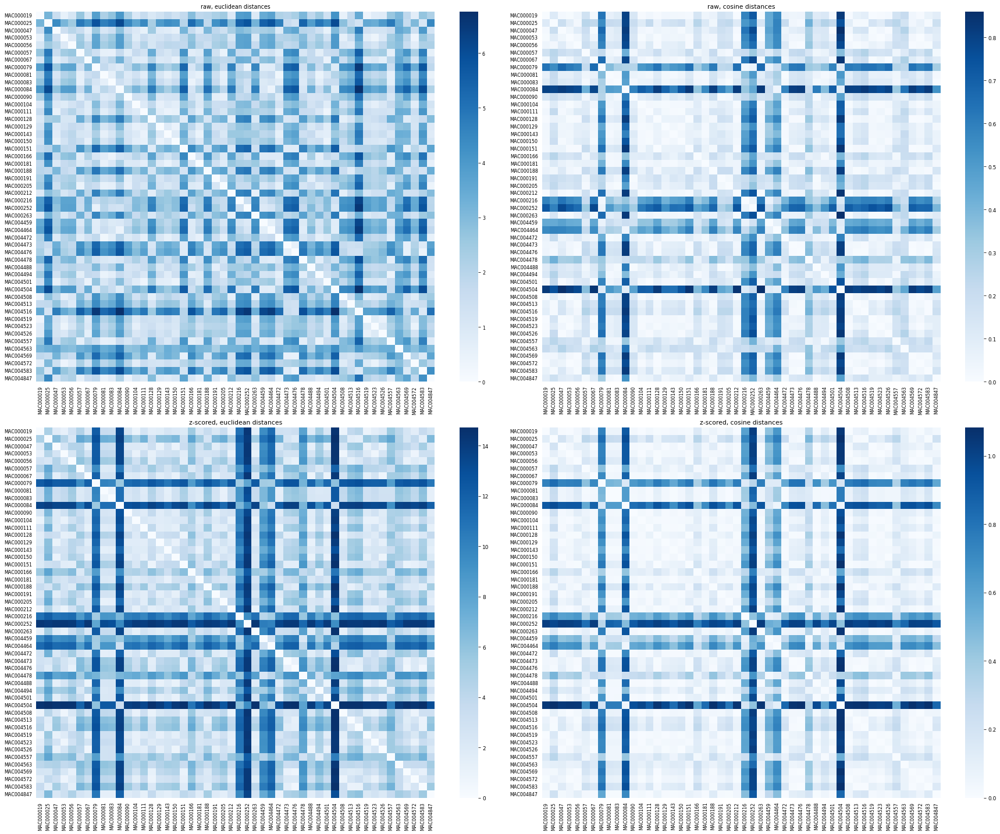

In [17]:
fed.show_distance_matrices(evaluation_vectors, evaluation_vectors_scaled)

### Start DCPSO

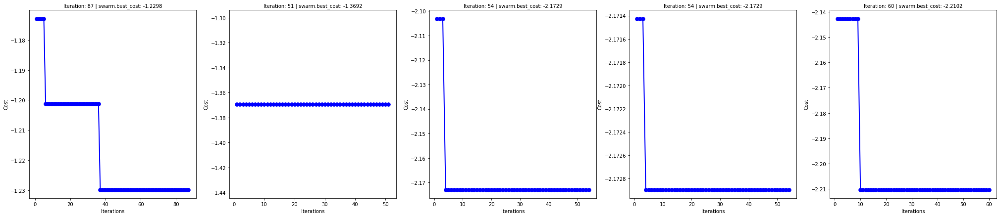

In [212]:
pso_obj_50 = PSO(samples=evaluation_vectors_scaled, max_n_clusters=15, n_iterations=5, n_particles=200, n_convergence=50, cluster_validation='dunn', distance_metric='cosine')
pso_obj_50.execute()

### 50 workers

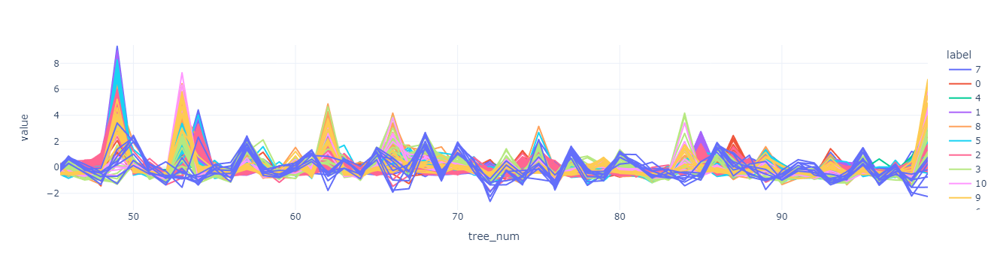

In [213]:
pso_obj_50.show_clusters()

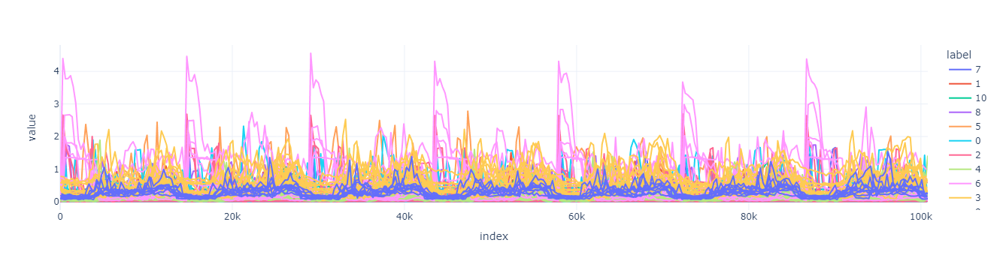

In [222]:
pso_obj_50.show_consumption_per_cluster(pso_obj_50.labels, prep, per_cluster=False)

### Concept drift detection

In [482]:
un, counts = np.unique(pso_obj_50.labels, return_counts=True)
counts 

array([27, 44, 35, 15, 39, 24,  8, 73, 20,  9,  6], dtype=int64)

In [483]:
un, counts = np.unique(pso_obj_50.labels, return_counts=True)
counts /300

array([0.09      , 0.14666667, 0.11666667, 0.05      , 0.13      ,
       0.08      , 0.02666667, 0.24333333, 0.06666667, 0.03      ,
       0.02      ])

In [327]:
dd_second = DriftDetector(pso_object=pso_obj_50, global_forest_trees=fed.global_forest, local_forest_list=fed.all_forests, prep_data=prep.features_dict, forest_support_threshold=0.03333, worker_repo_threshold=0.2)

In [357]:
rmse_dict_concept_drift = dd.get_daily_rmse_concept_drift(dd.pred_dict)

  0%|          | 0/300 [00:00<?, ?it/s]

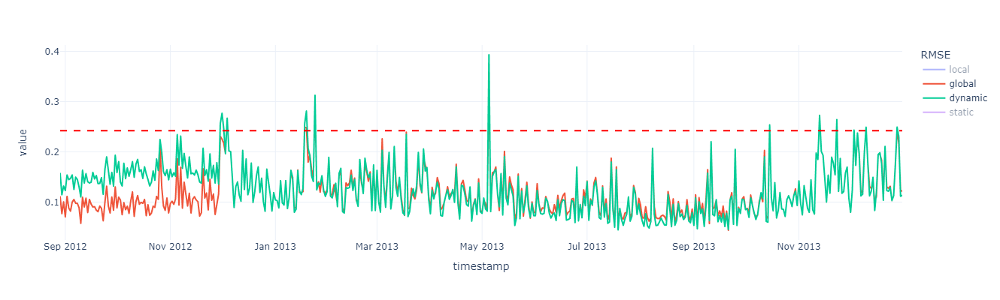

In [484]:
fig = px.line(rmse_dict_concept_drift['MAC000166'].rename({'active': 'dynamic', 'without_maintenance': 'static'}, axis=1), template='plotly_white', width=800, height=400, labels={'variable': 'RMSE'})
# for time in dd.maintenance_log.keys():
#     fig.add_vline(x=time, opacity=0.5, line_color='red')  
    
fig.add_hline(dd.thresh_dict['MAC000166'], line_color='red', line_dash='dash')
fig.show()

In [ ]:
monitor_forecast(dd.pred_dict, rmse_dict_concept_drift, dd.thresh_dict, show_forecast=False)

In [328]:
pred_dict_val, rmse_dict_val = dd_second.predict(part='val')

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/490 [00:00<?, ?it/s]

2012-08-29: Cluster support too low, ['MAC000034', 'MAC000049', 'MAC000097', 'MAC000116', 'MAC000153', 'MAC004469', 'MAC004563', 'MAC004852'] moved to worker repository
2012-08-29: Cluster support too low, ['MAC000068', 'MAC000074', 'MAC000087', 'MAC000255', 'MAC000264', 'MAC004464', 'MAC004478', 'MAC004557', 'MAC004574'] moved to worker repository
2012-08-29: Cluster support too low, ['MAC000021', 'MAC000040', 'MAC000059', 'MAC000084', 'MAC000270', 'MAC004459'] moved to worker repository
2012-08-31: MAC000022 is removed from cluster forest, global forest is activated at 2012-08-31. worker repo is at 0.077
2012-08-31: MAC000148 is removed from cluster forest, global forest is activated at 2012-08-31. worker repo is at 0.080
2012-08-31: MAC000149 is removed from cluster forest, global forest is activated at 2012-08-31. worker repo is at 0.083
2012-09-02: MAC000118 is removed from cluster forest, global forest is activated at 2012-09-02. worker repo is at 0.087
2012-09-04: MAC004856 is r

Retrieving trees:   0%|          | 0/60 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/60 [00:00<?, ?it/s]

Performing PSO grouping...


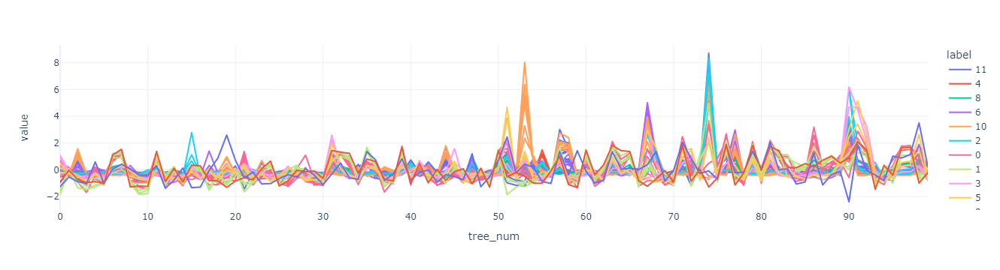

Creating new cluster models...
2013-01-11: Cluster support too low, ['MAC000040', 'MAC000049', 'MAC000116', 'MAC000153', 'MAC000245', 'MAC004549'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000024', 'MAC000034', 'MAC004458', 'MAC004469'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000059', 'MAC000069', 'MAC000084'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000022', 'MAC000270'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000074', 'MAC000156', 'MAC000255', 'MAC004462', 'MAC004478', 'MAC004581'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000021', 'MAC000087'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000068', 'MAC004499', 'MAC004557', 'MAC004861', 'MAC004865'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000105'] moved to worker repository
2013-01-11: Cluster support too low, ['MAC000079', 'MAC000097', 'MAC0044

Retrieving trees:   0%|          | 0/60 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/60 [00:00<?, ?it/s]

Performing PSO grouping...


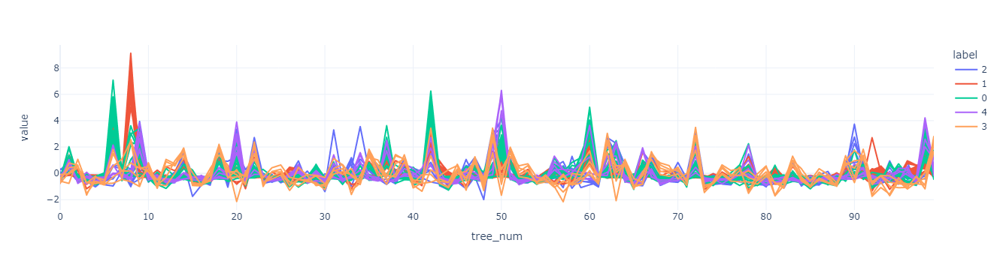

Creating new cluster models...
2013-02-26: Cluster support too low, ['MAC000021', 'MAC000040', 'MAC000049', 'MAC000116', 'MAC000252', 'MAC004500', 'MAC004549'] moved to worker repository
2013-02-26: Cluster support too low, ['MAC000034', 'MAC000105', 'MAC000153', 'MAC004458', 'MAC004469'] moved to worker repository
2013-02-26: Cluster support too low, ['MAC000059', 'MAC000084', 'MAC000087', 'MAC000270', 'MAC004464'] moved to worker repository
2013-03-01: MAC000148 is removed from cluster forest, global forest is activated at 2013-03-01. worker repo is at 0.057
2013-03-01: MAC000149 is removed from cluster forest, global forest is activated at 2013-03-01. worker repo is at 0.060
2013-03-01: MAC000167 is removed from cluster forest, global forest is activated at 2013-03-01. worker repo is at 0.063
2013-03-01: MAC000168 is removed from cluster forest, global forest is activated at 2013-03-01. worker repo is at 0.067
2013-03-01: MAC000196 is removed from cluster forest, global forest is ac

Retrieving trees:   0%|          | 0/60 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/60 [00:00<?, ?it/s]

Performing PSO grouping...


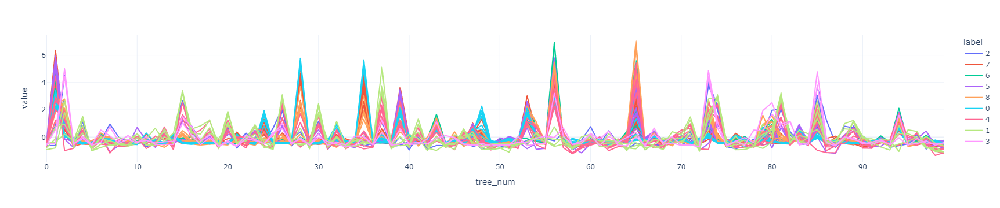

Creating new cluster models...
2013-05-31: Cluster support too low, ['MAC000040', 'MAC000049', 'MAC000105', 'MAC000116'] moved to worker repository
2013-05-31: Cluster support too low, ['MAC000021', 'MAC004527'] moved to worker repository
2013-05-31: Cluster support too low, ['MAC000059', 'MAC000270'] moved to worker repository
2013-05-31: Cluster support too low, ['MAC000097', 'MAC000153', 'MAC000245', 'MAC004458', 'MAC004549'] moved to worker repository
2013-05-31: Cluster support too low, ['MAC000027', 'MAC000079', 'MAC000094', 'MAC000252', 'MAC004469', 'MAC004528', 'MAC004581'] moved to worker repository
2013-05-31: Cluster support too low, ['MAC000081', 'MAC000084', 'MAC000087', 'MAC000145', 'MAC000156', 'MAC004462', 'MAC004574', 'MAC004852'] moved to worker repository
2013-05-31: Cluster support too low, ['MAC000068', 'MAC000243', 'MAC000255', 'MAC004459', 'MAC004464', 'MAC004478', 'MAC004557'] moved to worker repository
2013-06-03: MAC000149 is removed from cluster forest, globa

Retrieving trees:   0%|          | 0/60 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/60 [00:00<?, ?it/s]

Performing PSO grouping...


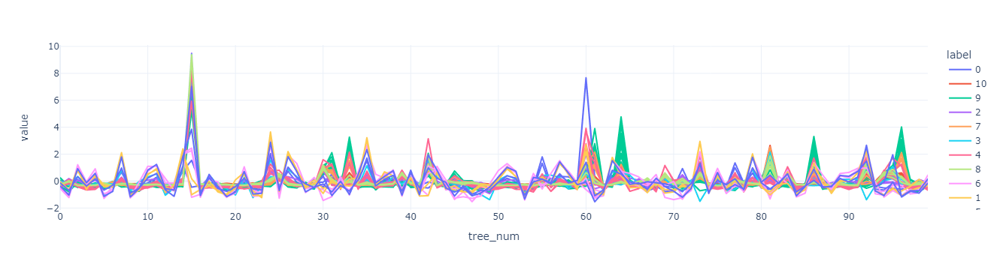

Creating new cluster models...
2013-10-07: Cluster support too low, ['MAC000021', 'MAC000270'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000040', 'MAC000116'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000059', 'MAC000084', 'MAC000087', 'MAC000252', 'MAC000262'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000079', 'MAC000153', 'MAC004581', 'MAC004852'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000068', 'MAC000255', 'MAC004459', 'MAC004478', 'MAC004557'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000097', 'MAC000245'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000049', 'MAC000105', 'MAC004458'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000027', 'MAC000081', 'MAC000181', 'MAC000217', 'MAC004464'] moved to worker repository
2013-10-07: Cluster support too low, ['MAC000145', 'MAC000156', 'MAC004462', 'MAC0045

Retrieving trees:   0%|          | 0/60 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/60 [00:00<?, ?it/s]

Performing PSO grouping...


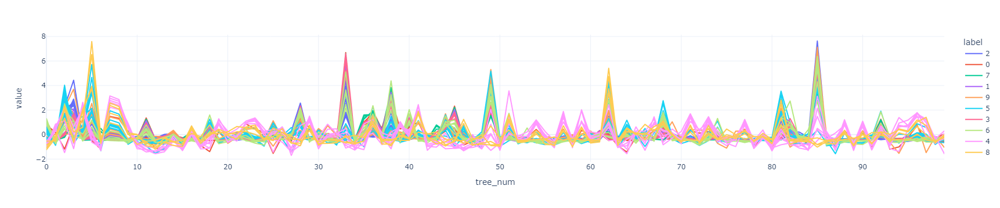

Creating new cluster models...
2013-10-30: Cluster support too low, ['MAC000148', 'MAC004469', 'MAC004563'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000217', 'MAC000220', 'MAC004477'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000102', 'MAC000118', 'MAC004481', 'MAC004512', 'MAC004569'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000049', 'MAC000105', 'MAC000153', 'MAC000245', 'MAC004458', 'MAC004579'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000166', 'MAC000167', 'MAC000181', 'MAC000201', 'MAC000213', 'MAC004464'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000089', 'MAC000149', 'MAC000168', 'MAC004520'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000021', 'MAC000040', 'MAC000116', 'MAC000270'] moved to worker repository
2013-10-30: Cluster support too low, ['MAC000087', 'MAC000145', 'MAC000156', 'MAC000176', 'MAC000252', 'MAC0045

Retrieving trees:   0%|          | 0/63 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/63 [00:00<?, ?it/s]

Performing PSO grouping...


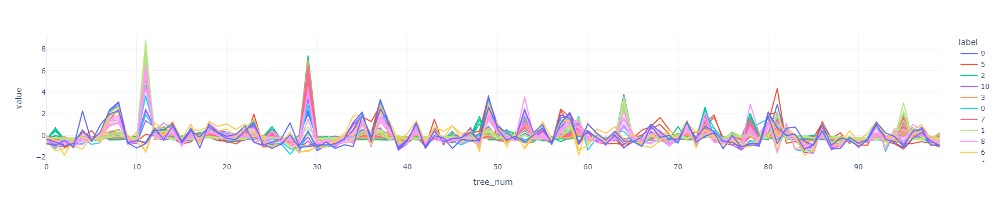

Creating new cluster models...
2013-11-25: Cluster support too low, ['MAC000153', 'MAC004549'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000087', 'MAC000156', 'MAC000176', 'MAC000252', 'MAC004581'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000116', 'MAC004579'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000021', 'MAC000270'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000040', 'MAC000105'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000022', 'MAC000060', 'MAC000081', 'MAC000098', 'MAC000166', 'MAC004457'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000079', 'MAC004468', 'MAC004469', 'MAC004852', 'MAC004865'] moved to worker repository
2013-11-25: Cluster support too low, ['MAC000018', 'MAC000145', 'MAC000244', 'MAC000264', 'MAC004464', 'MAC004528', 'MAC004570', 'MAC004574'] moved to worker repository
2013-11-25: Cluster support too l

Retrieving trees:   0%|          | 0/62 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/62 [00:00<?, ?it/s]

Performing PSO grouping...


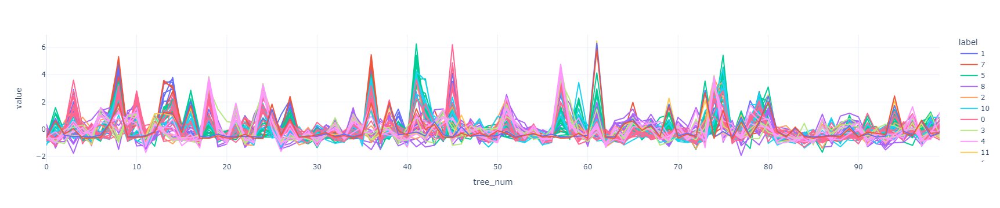

Creating new cluster models...
2013-12-03: Cluster support too low, ['MAC000022', 'MAC000059', 'MAC000084', 'MAC000087', 'MAC000255', 'MAC000262', 'MAC000270', 'MAC004464', 'MAC004478'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC000018', 'MAC000156', 'MAC000176', 'MAC000264', 'MAC004527', 'MAC004528', 'MAC004574', 'MAC004581'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC000021', 'MAC004549', 'MAC004865'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC000049', 'MAC000116', 'MAC004579'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC000079', 'MAC000097', 'MAC000245', 'MAC004459'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC004520'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC000148', 'MAC000244', 'MAC004570'] moved to worker repository
2013-12-03: Cluster support too low, ['MAC000040', 'MAC000105', 'MAC000153', 'MAC000252', 'MAC004458', 'MAC0044

Retrieving trees:   0%|          | 0/63 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/63 [00:00<?, ?it/s]

Performing PSO grouping...


Creating new cluster models...
2013-12-17: Cluster support too low, ['MAC004866'] moved to worker repository
2013-12-17: Cluster support too low, ['MAC000021', 'MAC000270', 'MAC004865'] moved to worker repository
2013-12-17: Cluster support too low, ['MAC000148'] moved to worker repository
2013-12-17: Cluster support too low, ['MAC000079', 'MAC000097', 'MAC000262', 'MAC004468'] moved to worker repository
2013-12-17: Cluster support too low, ['MAC000034', 'MAC000252', 'MAC004469'] moved to worker repository
2013-12-17: Cluster support too low, ['MAC000018', 'MAC000081', 'MAC000244', 'MAC000264', 'MAC004462', 'MAC004478', 'MAC004528', 'MAC004570', 'MAC004574'] moved to worker repository
2013-12-20: MAC000145 is removed from cluster forest, global forest is activated at 2013-12-20. worker repo is at 0.070
2013-12-20: MAC000149 is removed from cluster forest, global forest is activated at 2013-12-20. worker repo is at 0.073
2013-12-20: MAC000167 is removed from cluster forest, global fores

In [254]:
dd = DriftDetector(pso_object=pso_obj_50, global_forest_trees=fed.global_forest, local_forest_list=fed.all_forests, prep_data=prep.features_dict, forest_support_threshold=0.03333, worker_repo_threshold=0.2)
pred_dict_test, rmse_dict_test = dd.predict(part='test')
rmse_daily_test = dd.get_daily_rmse(pred_dict_test)
dd.determine_thresholds(rmse_dict=rmse_daily_test)
dd.drift_detection(cluster_validation='dunn')

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/490 [00:00<?, ?it/s]

2012-08-29: Cluster support too low, ['MAC000025', 'MAC000029', 'MAC000032', 'MAC000036', 'MAC000037', 'MAC000056', 'MAC000070', 'MAC000072', 'MAC000073', 'MAC000092', 'MAC000102', 'MAC000108', 'MAC000126', 'MAC000138', 'MAC000167', 'MAC000168', 'MAC000171', 'MAC000197', 'MAC000200', 'MAC000209', 'MAC000214', 'MAC000231', 'MAC000232', 'MAC000233', 'MAC000242', 'MAC000260', 'MAC000268', 'MAC000269', 'MAC004473', 'MAC004482', 'MAC004496', 'MAC004500', 'MAC004513', 'MAC004515', 'MAC004516', 'MAC004517', 'MAC004520', 'MAC004524', 'MAC004530', 'MAC004583', 'MAC004849', 'MAC004863'] moved to worker repository
2012-08-29: Cluster support too low, ['MAC000034', 'MAC000252', 'MAC004469', 'MAC004563', 'MAC004575'] moved to worker repository
2012-08-31: MAC000148 is removed from cluster forest, global forest is activated at 2012-08-31.
2012-08-31: MAC000149 is removed from cluster forest, global forest is activated at 2012-08-31.
2012-09-01: MAC000022 is removed from cluster forest, global forest

Retrieving trees:   0%|          | 0/111 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/111 [00:00<?, ?it/s]

Performing PSO grouping...


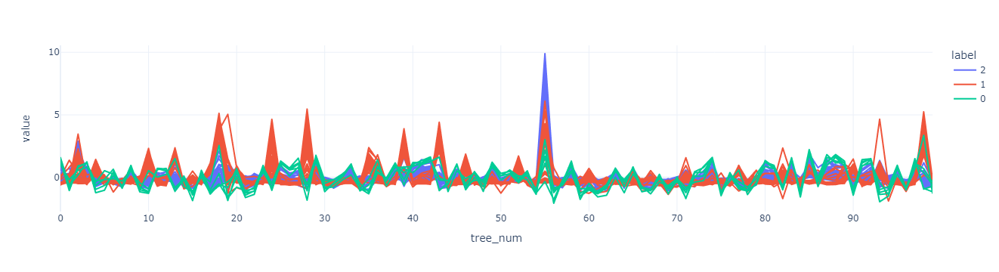

Creating new cluster models...
2012-11-30: MAC000027 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC000037 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC000149 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC000168 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC000197 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC000242 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC000252 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC004469 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC004520 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-30: MAC004581 is removed from cluster forest, global forest is activated at 2012-11-30.
2012-11-3

Retrieving trees:   0%|          | 0/109 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/109 [00:00<?, ?it/s]

Performing PSO grouping...


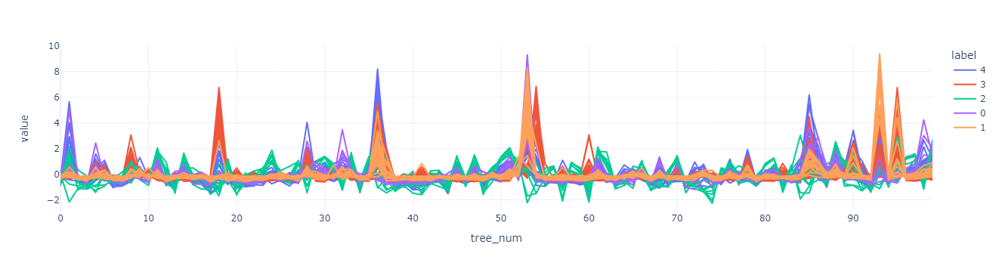

Creating new cluster models...
2012-12-03: MAC000037 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000079 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000148 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000149 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000167 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000168 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000197 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC000252 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC004468 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-03: MAC004866 is removed from cluster forest, global forest is activated at 2012-12-03.
2012-12-0

Retrieving trees:   0%|          | 0/109 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/109 [00:00<?, ?it/s]

Performing PSO grouping...


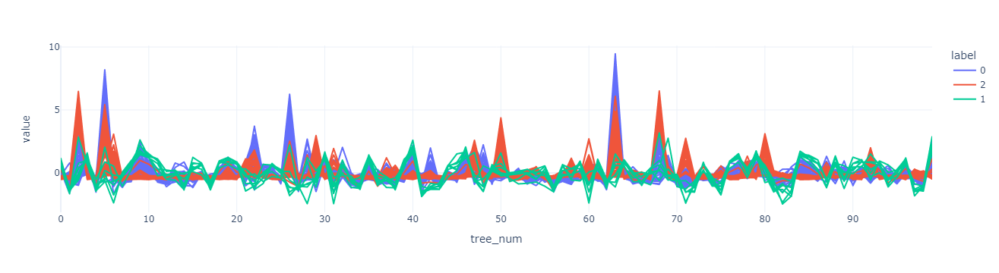

Creating new cluster models...
2012-12-04: MAC000024 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC000149 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC000167 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC000168 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC000197 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC000252 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC004468 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC004481 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: MAC004866 is removed from cluster forest, global forest is activated at 2012-12-04.
2012-12-04: Cluster support too low, ['MAC000034', 'MAC000079', 'MAC000105', 'MAC004469', 'MAC004563', 'M

Retrieving trees:   0%|          | 0/112 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/112 [00:00<?, ?it/s]

Performing PSO grouping...


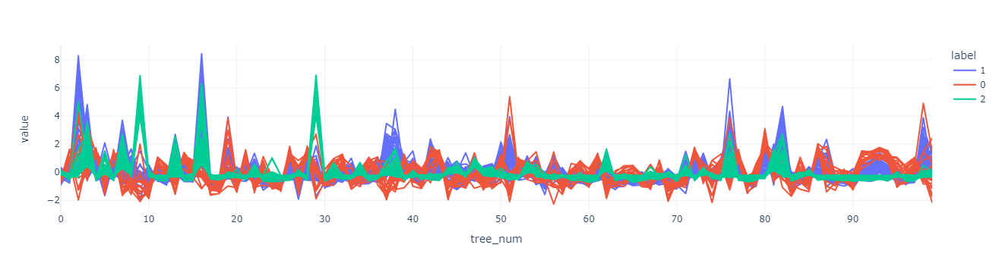

Creating new cluster models...
2012-12-14: MAC000105 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC000148 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC000149 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC000167 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC000168 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC000252 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC004468 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC004481 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC004549 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-14: MAC004584 is removed from cluster forest, global forest is activated at 2012-12-14.
2012-12-1

Retrieving trees:   0%|          | 0/110 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/110 [00:00<?, ?it/s]

Performing PSO grouping...


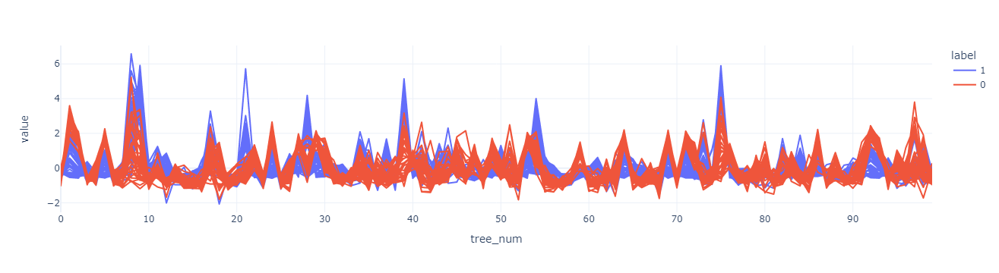

Creating new cluster models...
2012-12-22: MAC000036 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000037 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000102 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000105 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000108 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000148 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000149 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000167 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000168 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-22: MAC000176 is removed from cluster forest, global forest is activated at 2012-12-22.
2012-12-2

Retrieving trees:   0%|          | 0/120 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/120 [00:00<?, ?it/s]

Performing PSO grouping...


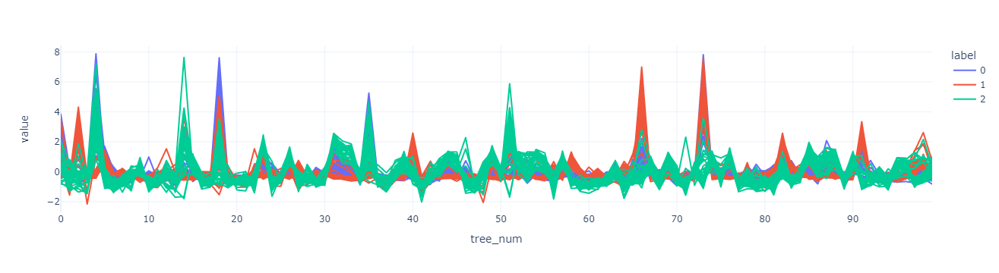

Creating new cluster models...
2013-02-07: MAC000034 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000037 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000105 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000148 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000149 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000167 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000168 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000197 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000209 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-07: MAC000233 is removed from cluster forest, global forest is activated at 2013-02-07.
2013-02-0

Retrieving trees:   0%|          | 0/120 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/120 [00:00<?, ?it/s]

Performing PSO grouping...


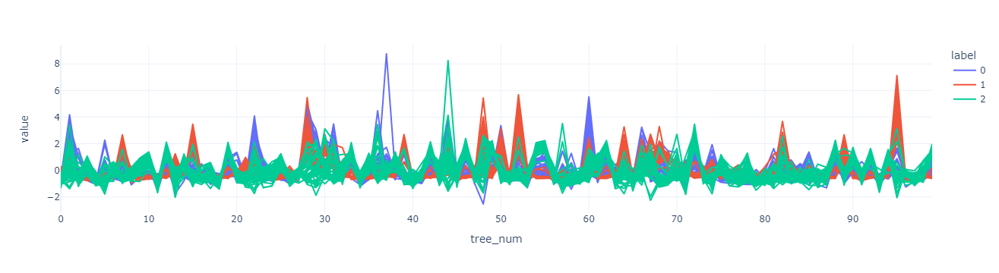

Creating new cluster models...
2013-02-08: MAC000034 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC000148 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC000149 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC000167 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC000168 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC000197 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC000252 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC004520 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC004574 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-08: MAC004866 is removed from cluster forest, global forest is activated at 2013-02-08.
2013-02-0

Retrieving trees:   0%|          | 0/120 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/120 [00:00<?, ?it/s]

Performing PSO grouping...


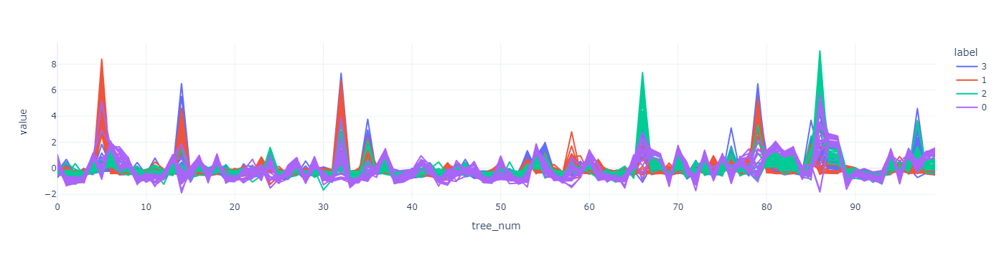

Creating new cluster models...
2013-02-09: MAC000034 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC000148 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC000149 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC000167 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC000197 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC004574 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC004861 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: MAC004866 is removed from cluster forest, global forest is activated at 2013-02-09.
2013-02-09: Cluster support too low, ['MAC000024', 'MAC000045', 'MAC000049', 'MAC000085', 'MAC000105', 'MAC000153', 'MAC000245', 'MAC000274', 'MAC004458', 'MAC004468', 'MAC004469', 'MAC004515', 'MAC004

Retrieving trees:   0%|          | 0/120 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/120 [00:00<?, ?it/s]

Performing PSO grouping...


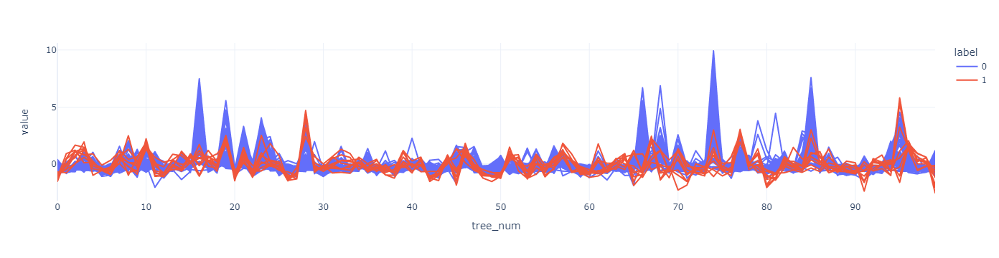

Creating new cluster models...
2013-02-13: MAC000027 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000034 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000035 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000148 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000149 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000167 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000197 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC000252 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC004462 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-13: MAC004468 is removed from cluster forest, global forest is activated at 2013-02-13.
2013-02-1

Retrieving trees:   0%|          | 0/90 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/90 [00:00<?, ?it/s]

Performing PSO grouping...


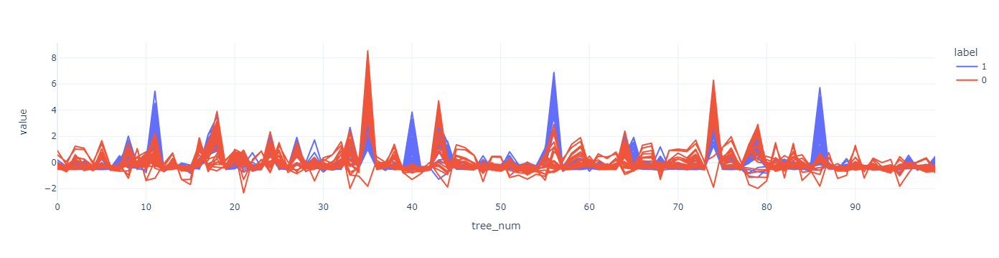

Creating new cluster models...
2013-05-06: MAC000037 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000098 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000108 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000125 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000148 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000149 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000167 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000168 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000197 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-06: MAC000209 is removed from cluster forest, global forest is activated at 2013-05-06.
2013-05-0

Retrieving trees:   0%|          | 0/104 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/104 [00:00<?, ?it/s]

Performing PSO grouping...


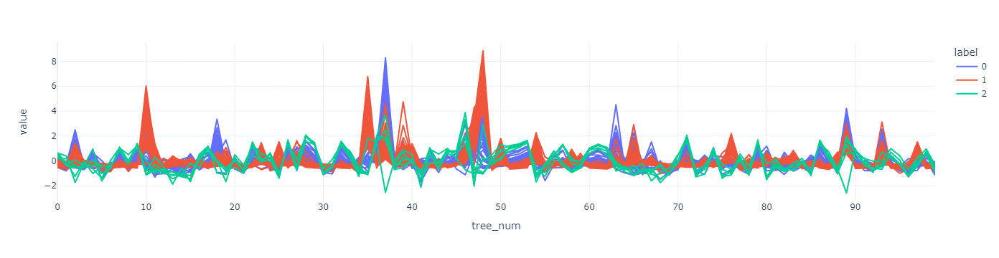

Creating new cluster models...
2013-10-20: MAC000148 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC000149 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC000167 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC000197 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC000245 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC004520 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC004528 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: MAC004579 is removed from cluster forest, global forest is activated at 2013-10-20.
2013-10-20: Cluster support too low, ['MAC000022', 'MAC000024', 'MAC000027', 'MAC000034', 'MAC000035', 'MAC000060', 'MAC000081', 'MAC000094', 'MAC000098', 'MAC000145', 'MAC000152', 'MAC000156', 'MAC000

Retrieving trees:   0%|          | 0/105 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/105 [00:00<?, ?it/s]

Performing PSO grouping...


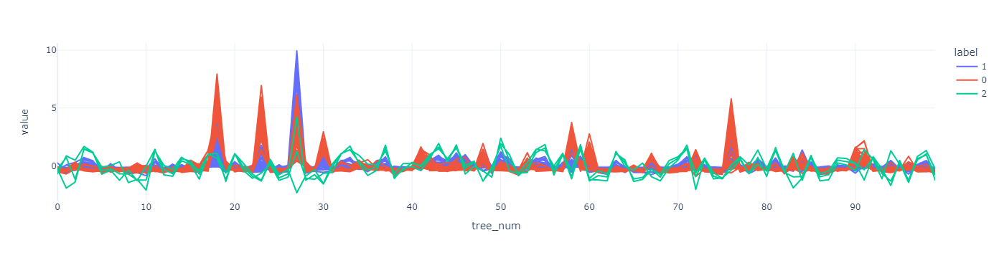

Creating new cluster models...
2013-11-19: MAC000089 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000105 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000145 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000148 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000149 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000167 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000168 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC000197 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC004512 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-19: MAC004520 is removed from cluster forest, global forest is activated at 2013-11-19.
2013-11-1

Retrieving trees:   0%|          | 0/107 [00:00<?, ?client/s]

Evaluating global forest...


  0%|          | 0/107 [00:00<?, ?it/s]

Performing PSO grouping...


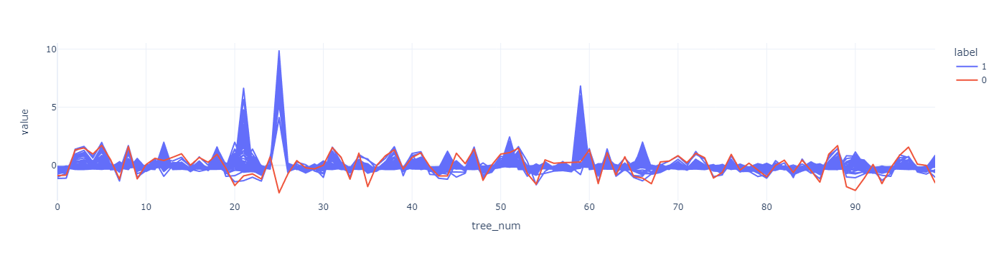

Creating new cluster models...
2013-11-25: MAC000036 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000037 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000089 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000105 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000108 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000118 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000145 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000148 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000149 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-25: MAC000167 is removed from cluster forest, global forest is activated at 2013-11-25.
2013-11-2

In [49]:
dd = DriftDetector(pso_object=pso_obj_50, global_forest_trees=fed.global_forest, local_forest_list=fed.all_forests, prep_data=prep.features_dict, forest_support_threshold=0.15, worker_repo_threshold=0.3)
pred_dict_test, rmse_dict_test = dd.predict(part='test')
rmse_daily_test = dd.get_daily_rmse(pred_dict_test)
dd.determine_thresholds(rmse_dict=rmse_daily_test)
dd.drift_detection(cluster_validation='silhouette')

In [126]:
np.unique(pso_obj_50.labels, return_counts=True)

(array([0, 1, 2, 3, 4, 5], dtype=int64),
 array([42, 67, 47,  5, 48, 91], dtype=int64))

In [214]:
np.unique(pso_obj_50.labels, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10], dtype=int64),
 array([27, 44, 35, 15, 39, 24,  8, 73, 20,  9,  6], dtype=int64))

In [177]:
10/300

0.03333333333333333

In [146]:
pred_dict_val, rmse_dict_val = dd.predict(part='val')
# rmse_daily_val = dd.get_daily_rmse(pred_dict_val)

  0%|          | 0/300 [00:00<?, ?it/s]

In [80]:
pred_dict_val, rmse_dict_val = dd2.predict(part='val')
rmse_daily_val = dd2.get_daily_rmse(pred_dict_val)

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/300 [00:00<?, ?it/s]

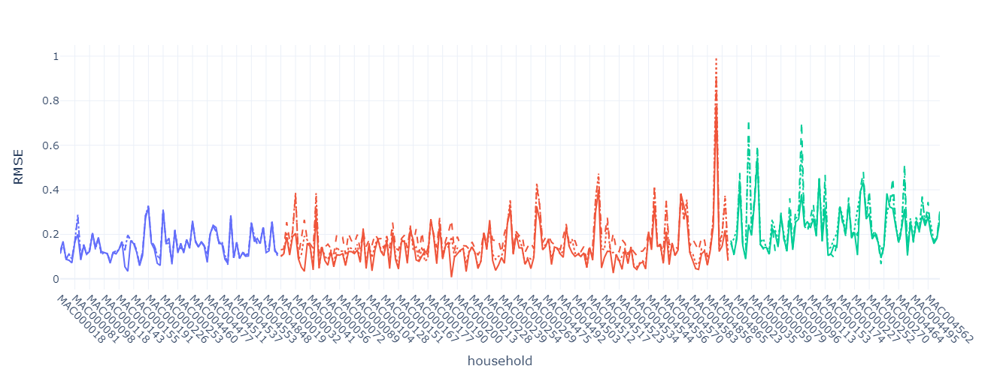

In [105]:
dd.plot_rmse_line(rmse_dict_val)

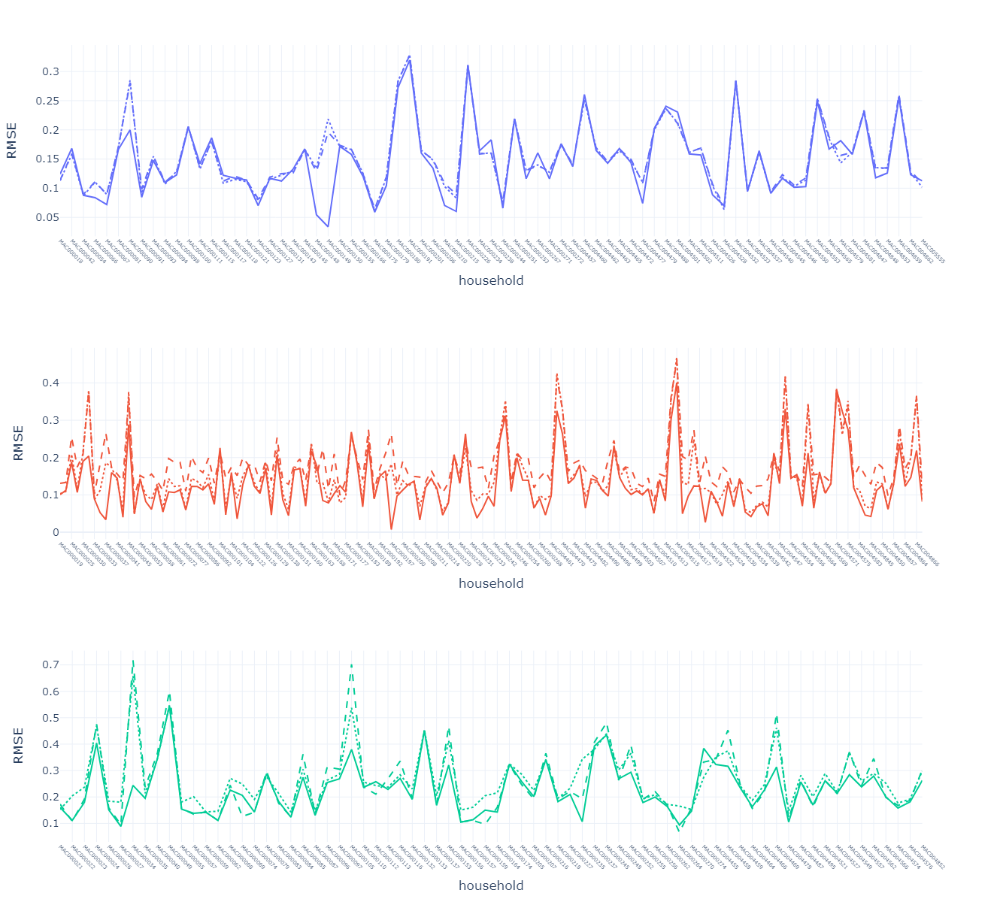

In [147]:
dd2.plot_rmse_line(rmse_dict_val)

In [73]:
with open("many_households/drift_detector.pkl", "rb") as input_file:
    dd2 = pickle.load(input_file)

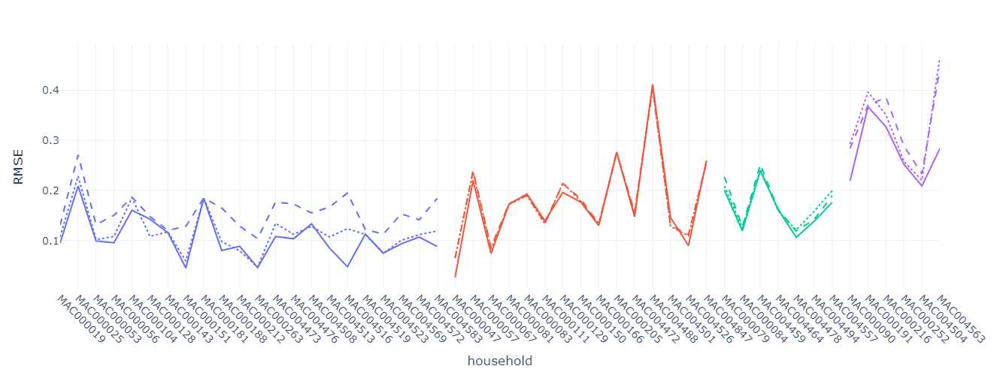

In [20]:
dd.plot_rmse_line(rmse_dict_test)

In [ ]:
monitor_forecast(dd.pred_dict, rmse_daily_val, dd.thresh_dict, show_forecast=False)

In [342]:
with open("many_households3/drift_detector.pkl", "wb") as input_file:
    pickle.dump(dd, input_file)

In [388]:
with open("many_households3/pso_labels.pkl", "wb") as input_file:
    pickle.dump(pso_obj_50.labels, input_file)

In [239]:
with open("many_households2/maintenance_log.pkl", "wb") as input_file:
    pickle.dump(dd.maintenance_log, input_file)

In [344]:
with open("many_households3/drift_detector.pkl", "rb") as input_file:
    s = pickle.load(input_file)
    
s

In [21]:
for worker in dd.pred_dict:
    dd.pred_dict[worker].dropna(inplace=True)

In [156]:
rmse_dict_concept_drift = dd.get_daily_rmse_concept_drift(dd.pred_dict)

  0%|          | 0/300 [00:00<?, ?it/s]

In [157]:
dd.plot_rmse_line(rmse_dict_concept_drift)

ValueError: Data must be 1-dimensional

In [211]:
monitor_forecast(dd.pred_dict, rmse_dict_concept_drift, dd.thresh_dict, show_forecast=False)

interactive(children=(SelectMultiple(description='Workers', options=('MAC000019', 'MAC000025', 'MAC000047', 'M…

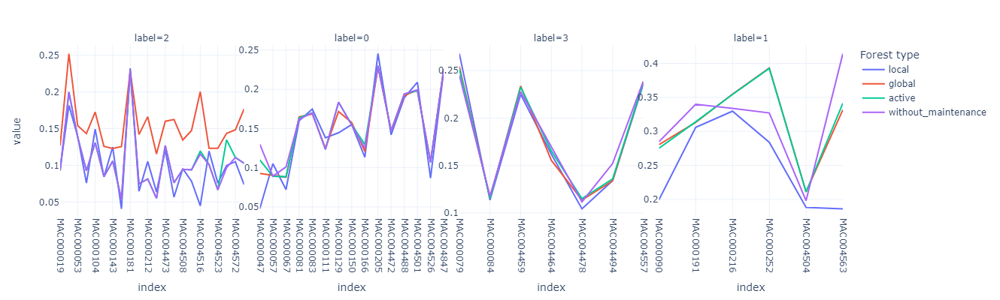

In [225]:
rmse_dict_concept_drift_avg = {worker:rmse_dict_concept_drift[worker].mean() for worker in rmse_dict_concept_drift}
dd.plot_rmse_line(rmse_dict_concept_drift_avg)

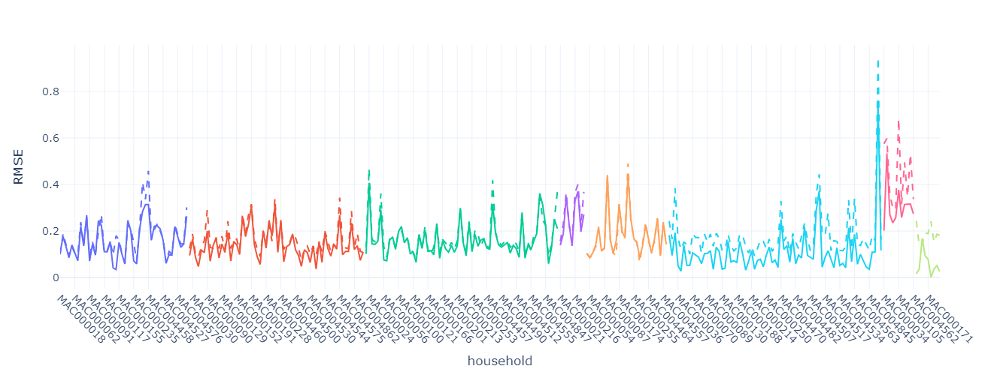

In [24]:
rmse_dict_concept_drift_avg = {worker:rmse_dict_concept_drift[worker].mean() for worker in rmse_dict_concept_drift}
dd.plot_rmse_line(rmse_dict_concept_drift_avg)

In [21]:
rmse_dict_concept_drift_avg = {worker:rmse_dict_concept_drift[worker].mean() for worker in rmse_dict_concept_drift}
dd.plot_rmse_line(rmse_dict_concept_drift_avg)

NameError: name 'rmse_dict_concept_drift' is not defined

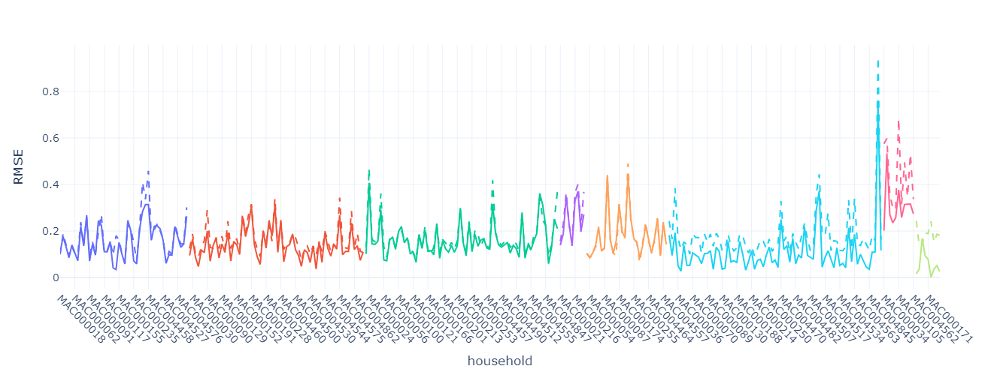

In [25]:
rmse_dict_concept_drift_avg = {worker:rmse_dict_concept_drift[worker].mean() for worker in rmse_dict_concept_drift}
dd.plot_rmse_line(rmse_dict_concept_drift_avg)

In [144]:
from statsmodels.stats.descriptivestats import sign_test
from scipy.stats import wilcoxon
from scipy.stats import binom
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error

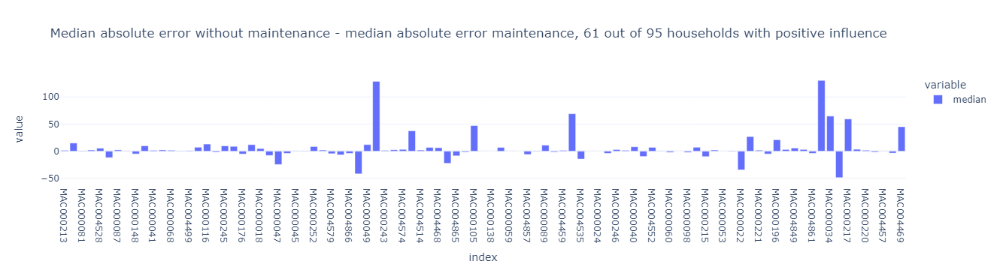

In [260]:
rmse_compare = pd.DataFrame()
for worker in influenced:
    worker_pred = dd.pred_dict[worker].copy()
    worker_pred = worker_pred.dropna()
    worker_pred['true'] = worker_pred['true'].astype(float)
    # worker_pred = worker_pred[worker_pred.pred != worker_pred.without_maintenance]
    # worker_pred = worker_pred[worker_pred.active_model != 'global']
    worker_pred['res_without'] = (worker_pred['without_maintenance'] - worker_pred['true']).abs()
    worker_pred['res_with_maintenance'] = (worker_pred['pred'] - worker_pred['true']).abs()
    
    rmse_with = mean_squared_error(worker_pred['true'], worker_pred['pred'], squared=False)
    rmse_without = mean_squared_error(worker_pred['true'], worker_pred['without_maintenance'], squared=False)
    
    # worker_pred['res_diff'] = worker_pred['res_without'] - worker_pred['res_with_maintenance']
    # worker_pred['res_diff'] = rmse_without - rmse_with
    rmse_compare.at[worker, 'median'] = calculate_percent_change(rmse_without, rmse_with)
    
    # print(worker)
    # print(worker_pred['res_without'].median())
    # print(worker_pred['res_with_maintenance'].median())
    # worker_pred.res_diff.median()
    
    # _, p = sign_test(household_df['diff'])
    # p = one_sided_sign_test(worker_pred['res_diff'], mu0=0, alternative='greater')
    # _, p = wilcoxon(x=worker_pred['res_diff'], alternative='greater')
    # print(worker, p)
    
    # rmse_compare.at[worker, 'median'] = rmse_without - rmse_with

px.bar(rmse_compare, template='plotly_white', title=f'Median absolute error without maintenance - median absolute error maintenance, {(rmse_compare > 0).sum().values[0]} out of {len(rmse_compare)} households with positive influence')

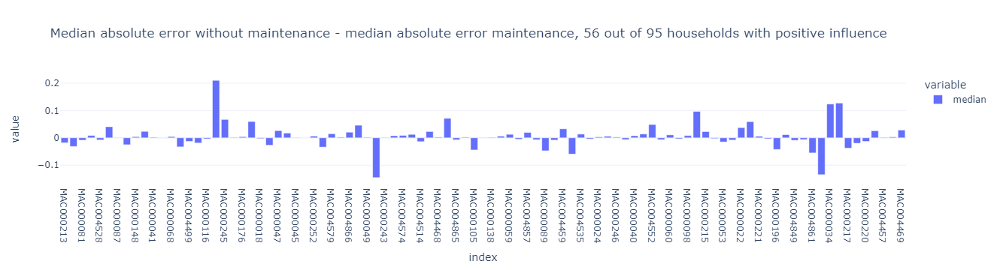

In [394]:
rmse_compare = pd.DataFrame()
for worker in influenced:
    worker_pred = dd.pred_dict[worker].copy()
    worker_pred = worker_pred.dropna()
    worker_pred['true'] = worker_pred['true'].astype(float)
    worker_pred = worker_pred[worker_pred.pred != worker_pred.without_maintenance]
    # worker_pred = worker_pred[worker_pred.active_model != 'global']
    worker_pred['res_without'] = (worker_pred['without_maintenance'] - worker_pred['true']).abs()
    worker_pred['res_with_maintenance'] = (worker_pred['pred'] - worker_pred['true']).abs()
    
    rmse_with = mean_squared_error(worker_pred['true'], worker_pred['pred'], squared=False)
    rmse_without = mean_squared_error(worker_pred['true'], worker_pred['without_maintenance'], squared=False)
    
    worker_pred['res_diff'] = worker_pred['res_without'] - worker_pred['res_with_maintenance']
    # worker_pred['res_diff'] = rmse_without - rmse_with
    rmse_compare.at[worker, 'median'] = worker_pred.res_diff.median()
    
    # _, p = sign_test(household_df['diff'])
    # p = one_sided_sign_test(worker_pred['res_diff'], mu0=0, alternative='greater')
    # _, p = wilcoxon(x=worker_pred['res_diff'], alternative='greater')
    # print(worker, p)
    
    # rmse_compare.at[worker, 'median'] = rmse_without - rmse_with

px.bar(rmse_compare, template='plotly_white', title=f'Median absolute error without maintenance - median absolute error maintenance, {(rmse_compare > 0).sum().values[0]} out of {len(rmse_compare)} households with positive influence')

In [262]:
(rmse_compare > 0).sum().values[0] / len(rmse_compare)

0.35789473684210527

In [191]:
def calculate_percentage_difference(number1, number2):
    numerator = abs(number1 - number2)
    denominator = (number1 + number2) / 2
    percentage_difference = (numerator / denominator) * 100
    return percentage_difference

def calculate_percent_change(old_value, new_value):
    percent_change = ((new_value - old_value) / old_value) * 100
    return percent_change

In [197]:
import scipy.stats as stats
def sign_test_own(paired_data, alternative='two-sided'):
    """
    Perform a sign test for matched pairs.

    Parameters:
        paired_data (list): List of paired observations.
        alternative (str, optional): The alternative hypothesis. Can be 'two-sided', 'greater', or 'less'.
                                    Default is 'two-sided'.

    Returns:
        str: A string indicating whether the null hypothesis is rejected.
        float: The calculated p-value.
    """
    
    plus_count = sum(diff > 0 for diff in paired_data)
    minus_count = sum(diff < 0 for diff in paired_data)
    n_total = plus_count + minus_count
    
    
    t = stats.binomtest(plus_count, n_total, 0.5, alternative=alternative)
    p_value = t.pvalue
    return p_value

In [246]:
rmse_compare

,median
MAC000021,12.980736
MAC000166,12.984075
MAC004457,0.919594
MAC000246,5.246312
MAC000233,99.977912
...,...
MAC000097,3.555458
MAC004569,3.824166
MAC004459,-0.128363
MAC000055,1.764856


In [438]:
sign_test_own(rmse_compare['median'].values, alternative='greater')

0.002757600742750555

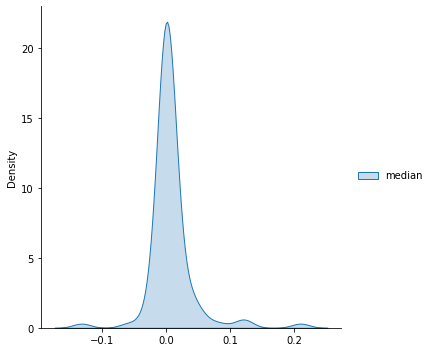

In [490]:
sb.displot(rmse_compare, kind='kde', fill=True)

In [249]:
with open("many_households2/maintenance_log.pkl", "rb") as input_file:
    maintenance_log = pickle.load(input_file)
    
with open("many_households2/pred_dict.pkl", "rb") as input_file:
    pred_dict = pickle.load(input_file)

In [249]:
with open("many_households/drift_detector.pkl", "rb") as input_file:
    maintenance_log = pickle.load(input_file)
    
with open("many_households2/pred_dict.pkl", "rb") as input_file:
    pred_dict = pickle.load(input_file)

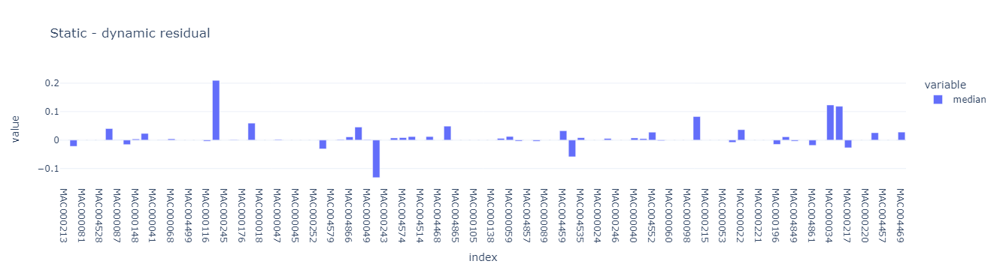

In [486]:
# with open("../many_households/maintenance_log.pkl", "rb") as input_file:
#     ml = pickle.load(input_file)
    
# with open("../many_households/pred_dict.pkl", "rb") as input_file:
#     s = pickle.load(input_file)
    
rmse_compare = pd.DataFrame()
for worker in influenced:
    worker_pred = dd.pred_dict[worker].copy()
    worker_pred = worker_pred.dropna()
    # worker_pred = worker_pred[worker_pred.pred != worker_pred.without_maintenance]
    worker_pred['true'] = worker_pred['true'].astype(float)
    worker_pred['res_without'] = (worker_pred['without_maintenance'] - worker_pred['true']).abs()
    worker_pred['res_with_maintenance'] = (worker_pred['pred'] - worker_pred['true']).abs()
    
    worker_pred['res_diff'] = worker_pred['res_without'] - worker_pred['res_with_maintenance']
    
    # _, p = sign_test(household_df['diff'])
    # p = one_sided_sign_test(worker_pred['res_diff'], mu0=0, alternative='greater')
    # _, p = wilcoxon(x=worker_pred['res_diff'], alternative='greater')
    # print(worker, p)
    
    rmse_compare.at[worker, 'median'] = worker_pred.res_diff.median()
    
px.bar(rmse_compare, template='plotly_white', title=f'Static - dynamic residual')

In [ ]:
# with open("../many_households/maintenance_log.pkl", "rb") as input_file:
#     ml = pickle.load(input_file)
    
# with open("../many_households/pred_dict.pkl", "rb") as input_file:
#     s = pickle.load(input_file)
    
rmse_compare = pd.DataFrame()
for worker in influenced:
    worker_pred = s[worker].copy()
    worker_pred = worker_pred.dropna()
    worker_pred = worker_pred[worker_pred.pred != worker_pred.without_maintenance]
    worker_pred = worker_pred[worker_pred.active_model != 'global']
    print(len(worker_pred))
    worker_pred['true'] = worker_pred['true'].astype(float)
    worker_pred['res_without'] = (worker_pred['without_maintenance'] - worker_pred['true']).abs()
    worker_pred['res_with_maintenance'] = (worker_pred['pred'] - worker_pred['true']).abs()
    
    worker_pred['res_diff'] = worker_pred['res_without'] - worker_pred['res_with_maintenance']
    
    # _, p = sign_test(household_df['diff'])
    # p = one_sided_sign_test(worker_pred['res_diff'], mu0=0, alternative='greater')
    # _, p = wilcoxon(x=worker_pred['res_diff'], alternative='greater')
    # print(worker, p)
    
    rmse_compare.at[worker, 'median'] = worker_pred.res_diff.mean()
    
px.bar(rmse_compare, template='plotly_white')

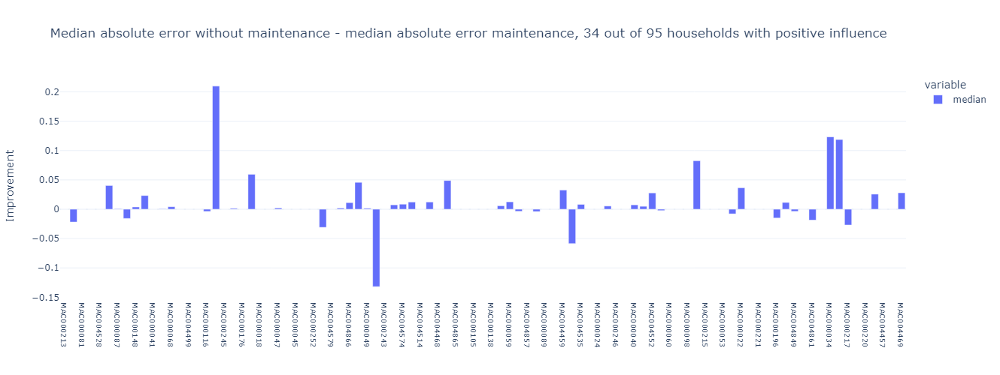

In [509]:
# with open("../many_households/maintenance_log.pkl", "rb") as input_file:
#     ml = pickle.load(input_file)
    
# with open("../many_households/pred_dict.pkl", "rb") as input_file:
#     s = pickle.load(input_file)
    
rmse_compare = pd.DataFrame()
for worker in influenced:
    worker_pred = dd.pred_dict[worker].copy()
    worker_pred = worker_pred.dropna()
    # worker_pred = worker_pred[worker_pred.pred != worker_pred.without_maintenance]
    # worker_pred = worker_pred[worker_pred.active_model != 'global']
    worker_pred['true'] = worker_pred['true'].astype(float)
    worker_pred['res_without'] = (worker_pred['without_maintenance'] - worker_pred['true']).abs()
    worker_pred['res_with_maintenance'] = (worker_pred['pred'] - worker_pred['true']).abs()
    
    worker_pred['res_diff'] = worker_pred['res_without'] - worker_pred['res_with_maintenance']
    
    # _, p = sign_test(household_df['diff'])
    # p = one_sided_sign_test(worker_pred['res_diff'], mu0=0, alternative='greater')
    # _, p = wilcoxon(x=worker_pred['res_diff'], alternative='greater')
    # print(worker, p)
    
    # rmse_compare.at[worker, 'static'] = worker_pred['res_without'].median() 
    # rmse_compare.at[worker, 'dynamic'] = worker_pred['res_with_maintenance'].median()
    rmse_compare.at[worker, 'median'] = worker_pred['res_diff'].median()
    # rmse_compare.at[worker, 'median'] = worker_pred['res_without'].median() - worker_pred['res_with_maintenance'].median()
    
    
fig = px.bar(rmse_compare, template='plotly_white', height=500, width=1200, labels={'value': 'Improvement'}, title=f'Median absolute error without maintenance - median absolute error maintenance, {(rmse_compare > 0).sum().values[0]} out of {len(rmse_compare)} households with positive influence'    )
fig.update_xaxes(tickfont=dict(size=10), title_text='')
fig.show()

In [506]:
sign_test_own(rmse_compare.static - rmse_compare.dynamic, alternative='greater')

0.0752590319451147

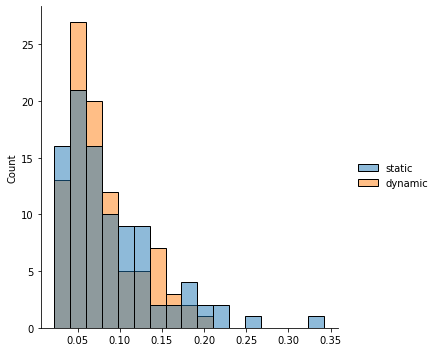

In [501]:
sb.displot(rmse_compare, kind='hist', fill=True)

In [516]:
rmse_compare

,median
MAC000213,0.000000
MAC004569,-0.021844
MAC000081,0.000000
MAC000262,0.000000
MAC004528,0.000000
...,...
MAC000220,0.000000
MAC000074,0.025760
MAC004457,0.000000
MAC000201,0.000000


In [543]:
sign_test_own(rmse_compare['median'].values, alternative='greater')

0.002757600742750555

<Figure size 1440x1440 with 0 Axes>

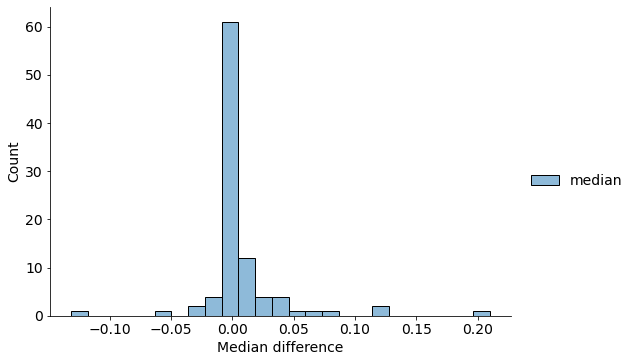

In [542]:
plt.figure(figsize=(20, 20))
plt.rcParams['font.size'] = 14
g = sb.displot(rmse_compare, kind='hist', fill=True, bins=25, aspect=1.5)
plt.xlabel('Median difference')
plt.show()

In [256]:
influenced = []
for event in dd.maintenance_log:
    influenced.extend(dd.maintenance_log[event])
    
influenced = list(set(influenced))

In [414]:
full_pred = pd.concat(dd.pred_dict).reset_index()
full_pred['true'] = full_pred['true'].astype(float)
full_pred['res_without'] = (full_pred['without_maintenance'] - full_pred['true']).abs()
full_pred['res_with_maintenance'] = (full_pred['pred'] - full_pred['true']).abs()
full_pred['res_global'] = (full_pred['global_pred'] - full_pred['true']).abs()
full_pred['res_diff'] = full_pred['res_without'] - full_pred['res_with_maintenance']
full_pred

,level_0,timestamp,pred,local_pred,global_pred,without_maintenance,true,active_model,res_without,res_with_maintenance,res_global,res_diff
0,MAC000018,2012-05-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,MAC000018,2012-05-01 00:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,MAC000018,2012-05-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,MAC000018,2012-05-01 01:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,MAC000018,2012-05-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
8769536,MAC005555,2013-12-31 21:30:00,0.174778,0.124646,0.169635,0.174778,0.143,cluster,0.031778,0.031778,0.026635,0.0
8769537,MAC005555,2013-12-31 22:00:00,0.183410,0.135456,0.187159,0.183410,0.117,cluster,0.066410,0.066410,0.070159,0.0
8769538,MAC005555,2013-12-31 22:30:00,0.170444,0.105909,0.169612,0.170444,0.130,cluster,0.040444,0.040444,0.039612,0.0
8769539,MAC005555,2013-12-31 23:00:00,0.179968,0.118749,0.197228,0.179968,0.084,cluster,0.095968,0.095968,0.113228,0.0


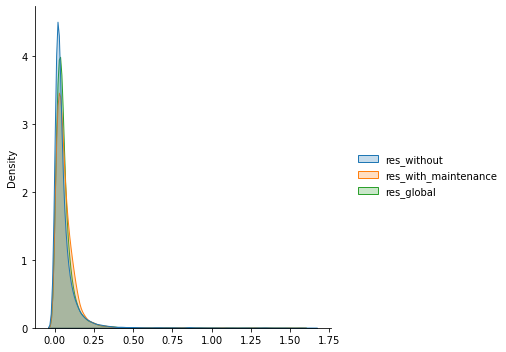

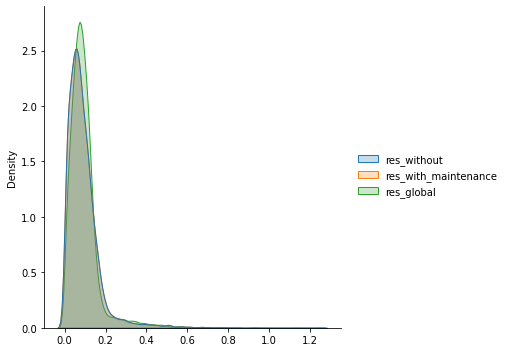

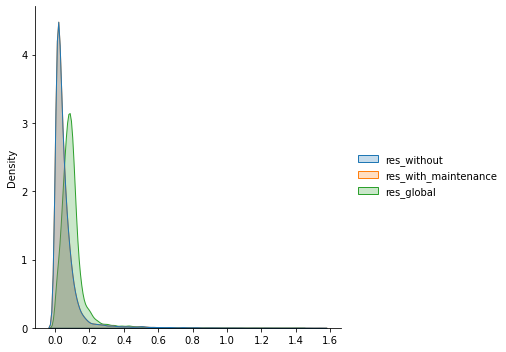

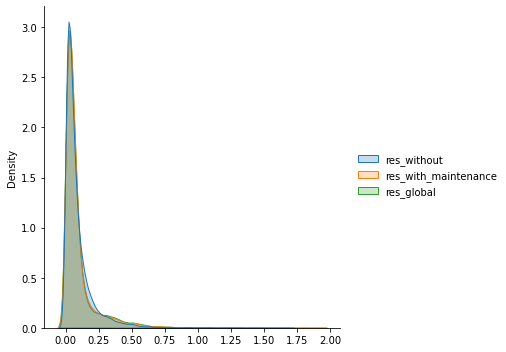

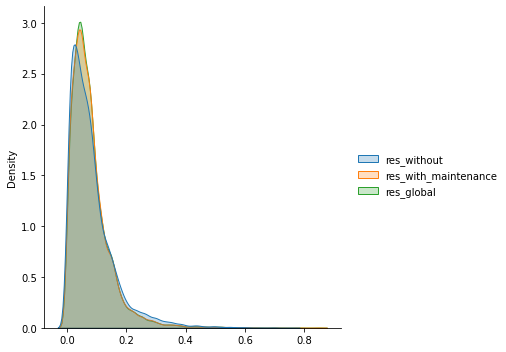

...

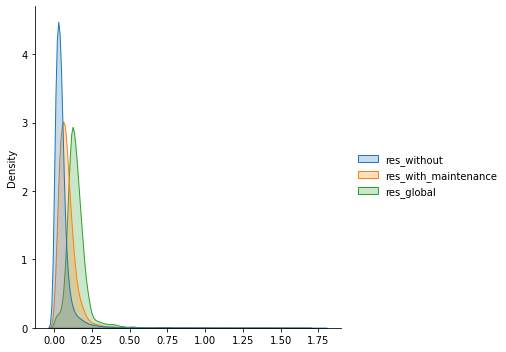

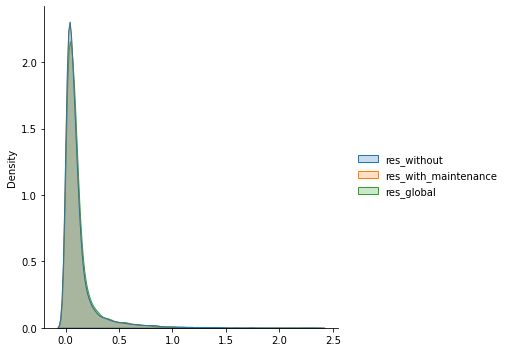

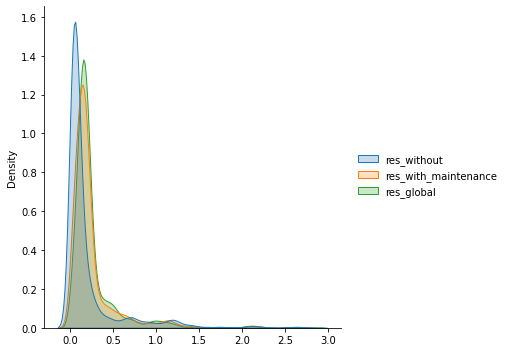

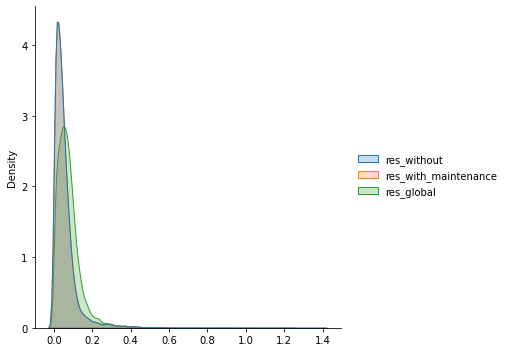

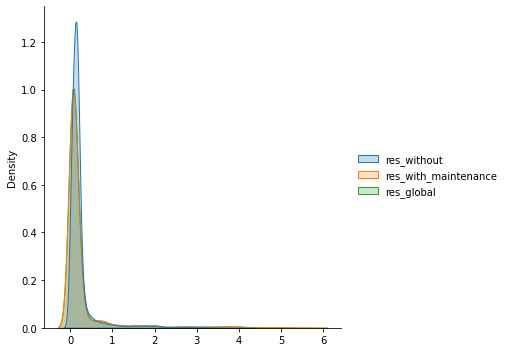

In [201]:
for hh in full_pred.level_0.unique()[:15]:
    f = full_pred[full_pred.level_0 == hh].dropna()
    g = sb.displot(f[['res_without', 'res_with_maintenance', 'res_global']], kind='hist', fill=True)
    plt.show()

In [304]:
full_pred.level_0.apply(lambda x: x in influenced).values

array([ True,  True,  True, ..., False, False, False])

In [434]:
full_pred = pd.concat(dd.pred_dict).reset_index()
full_pred['true'] = full_pred['true'].astype(float)
full_pred['static'] = (full_pred['without_maintenance'] - full_pred['true']).abs()
full_pred['dynamic'] = (full_pred['pred'] - full_pred['true']).abs()
full_pred['res_diff'] = full_pred['static'] - full_pred['dynamic']

timestamp_counts = full_pred.groupby('timestamp').level_0.agg('count').reset_index()
timestamps_to_drop = timestamp_counts[timestamp_counts.level_0 < 100].timestamp.values
full_pred['maintained'] = full_pred.level_0.apply(lambda x: x in influenced).values

full_pred = full_pred[~full_pred.timestamp.isin(timestamps_to_drop)]
full_pred['day'] = full_pred.timestamp.dt.date

median_per_timestamp = full_pred.groupby(['maintained', 'day']).agg(np.median).reset_index()
median_per_timestamp

,maintained,day,pred,local_pred,global_pred,without_maintenance,true,static,dynamic,res_diff
0,False,2012-05-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,False,2012-05-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,False,2012-05-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,False,2012-05-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,False,2012-05-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1215,True,2013-12-27,0.228068,0.213858,0.235420,0.237489,0.1660,0.075155,0.079561,-0.000243
1216,True,2013-12-28,0.235791,0.216285,0.241444,0.246543,0.1690,0.076816,0.077345,-0.001779
1217,True,2013-12-29,0.237675,0.227379,0.245324,0.249524,0.1690,0.074673,0.079994,-0.002198
1218,True,2013-12-30,0.239753,0.231755,0.250013,0.259472,0.1915,0.077039,0.079076,0.000414


In [311]:
full_pred.rolling(24, step=6).median()

,pred,local_pred,global_pred,without_maintenance,true,res_without,res_with_maintenance,res_global,res_diff,maintained
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...
8769516,0.123202,0.095131,0.133591,0.123202,0.0920,0.035142,0.035142,0.044329,0.0,0.0
8769522,0.129476,0.097191,0.134721,0.129476,0.0860,0.045324,0.045324,0.045613,0.0,0.0
8769528,0.134475,0.100580,0.138666,0.134475,0.0820,0.061514,0.061514,0.068255,0.0,0.0
8769534,0.150859,0.107085,0.148091,0.150859,0.0835,0.070402,0.070402,0.071721,0.0,0.0


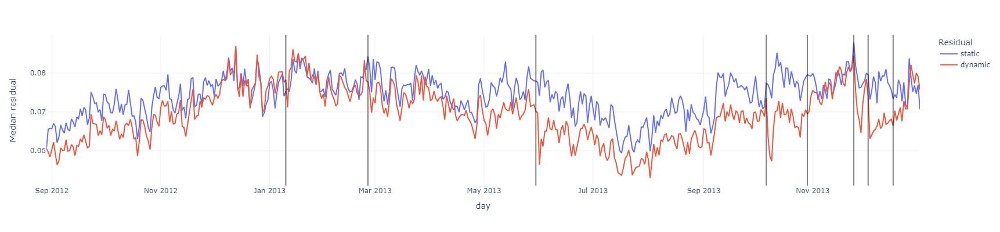

In [478]:
fig = px.line(median_per_timestamp[median_per_timestamp.maintained].dropna()[['static', 'dynamic', 'day']], x='day', y=['static', 'dynamic'], template='plotly_white', labels={'variable': 'Residual', 'value': 'Median residual'}, height=400, width=1200)
for time in dd.maintenance_log.keys():
    fig.add_vline(x=time, opacity=0.5, line_color='black')  
fig.show()

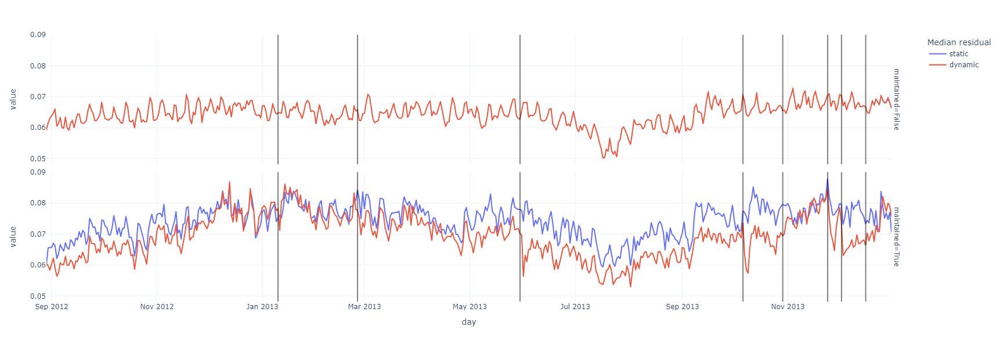

In [435]:
fig = px.line(median_per_timestamp.dropna()[['static', 'dynamic', 'day', 'maintained']], x='day', y=['static', 'dynamic'], facet_row='maintained', height=600, template='plotly_white', labels={'variable': 'Median residual'})
for time in dd.maintenance_log.keys():
    fig.add_vline(x=time, opacity=0.5, line_color='black')  
fig.show()

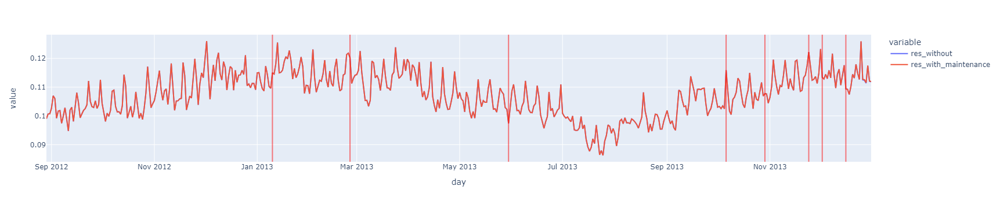

In [274]:
fig = px.line(median_per_timestamp.dropna()[['res_without', 'res_with_maintenance', 'day']], x='day', y=['res_without', 'res_with_maintenance'])
for time in dd.maintenance_log.keys():
    fig.add_vline(x=time, opacity=0.5, line_color='red')  
fig.show()

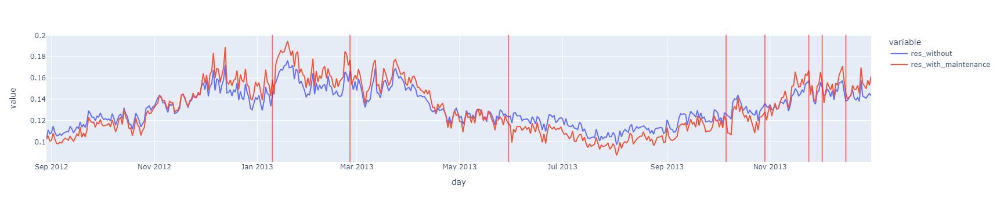

In [271]:
fig = px.line(median_per_timestamp.dropna()[['res_without', 'res_with_maintenance', 'day']], x='day', y=['res_without', 'res_with_maintenance'])
for time in dd.maintenance_log.keys():
    fig.add_vline(x=time, opacity=0.5, line_color='red')  
fig.show()

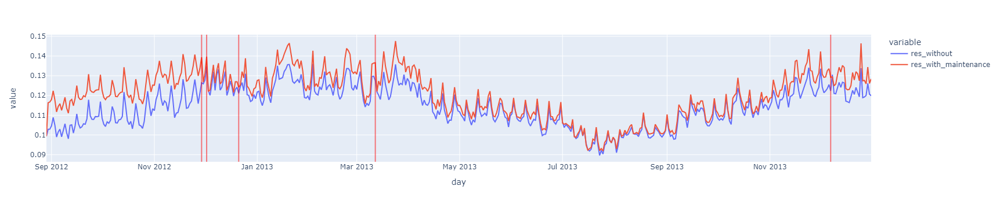

In [253]:
fig = px.line(median_per_timestamp.dropna()[['res_without', 'res_with_maintenance', 'day']], x='day', y=['res_without', 'res_with_maintenance'])
for time in maintenance_log.keys():
    fig.add_vline(x=time, opacity=0.5, line_color='red')  
fig.show()

maintained vs not maintained

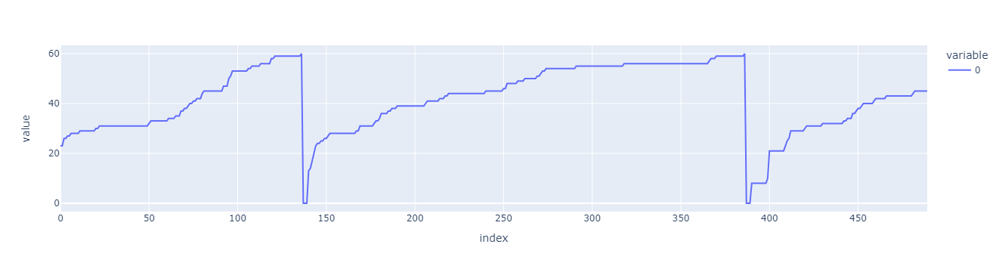

In [237]:
px.line(dd.worker_repository_hist)

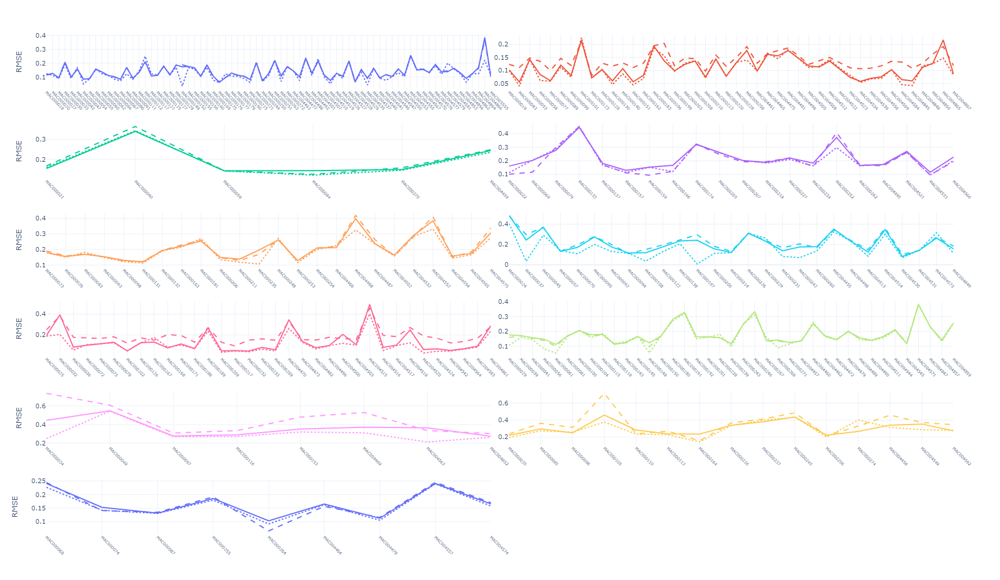

In [452]:
def plot_rmse_line(rmse_dict):
    # df = pd.DataFrame(rmse_dict, index=['local', 'global', 'active', 'without_maintenance']).T
    df = pd.DataFrame(rmse_dict, index=['local', 'federated', 'global']).T

    df['cluster'] = dd_second.labels
    df = df.drop('MAC004863')
    df = df.melt(id_vars='cluster', ignore_index=False)
    fig = px.line(data_frame=df, y='value', line_dash='variable', template='plotly_white', facet_col='cluster', facet_col_wrap=2, color='cluster', height=1000, line_dash_sequence=['dot', 'solid', 'dash'], width=1300,
                  labels={'variable': 'Forest type', 'value': 'RMSE'}
                  )
    fig.update_layout(font=dict(size=11))  # Set the font size here))
    fig.update_xaxes(matches=None, mirror='all', automargin=True)
    # fig.update_yaxes(matches=None)
    fig.for_each_yaxis(lambda yaxis: yaxis.update(showticklabels=True))
    fig.update_layout(showlegend=False)
    fig.for_each_annotation(lambda a: a.update(text=''))
    # fig.update_layout(xaxes=dict(tickfont=dict(size=2)))
    # fig.update_layout(autosize=False,
    #                     width=1000,
    #                     height=1200,)
    fig.update_yaxes(matches=None)
    fig.update_xaxes(tickfont=dict(size=7), title_text='')

    # fig.update_layout(legend=dict(title='Model',
    #                     orientation="h",
    #                     entrywidth=50,
    #                     yanchor="bottom",
    #                     y=1.02,
    #                     xanchor="right",
    #                     x=1
    #                 ))
    fig.for_each_xaxis(lambda xaxis: xaxis.update(showticklabels=True, tickangle=45, title=''))

    fig.show()
plot_rmse_line(rmse_dict_val)